# Weather Forecasting: Wind Speed Analysis

In [1]:
## Submitted by - 
## Name    : Aditi M. Chavan 
## Roll no : PB54
## PRN     : 1032170868

# Import Libraries and Dataset

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
# read Turbine dataset
df = pd.read_csv("C:\\Users\\Aditi\\Desktop\\ML\\Mini Project\\Turbine_Data.csv")
df.tail()

,Unnamed: 0,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,...,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WTG,WindDirection,WindSpeed
118219,2020-03-30 23:10:00+00:00,70.044465,27.523741,45.711129,1.515669,1.950088,1.950088,0.0,59.821165,55.193793,...,58.148777,39.008931,36.476562,178.0,13.775785,9.234004,2.0,G01,178.0,3.533445
118220,2020-03-30 23:20:00+00:00,40.833474,27.602882,45.598573,1.702809,2.136732,2.136732,0.0,59.142038,54.798545,...,57.550367,39.006759,36.328125,178.0,8.088928,9.229370,2.0,G01,178.0,3.261231
118221,2020-03-30 23:30:00+00:00,20.777790,27.560925,45.462045,1.706214,2.139664,2.139664,0.0,58.439439,54.380456,...,57.099335,39.003815,36.131944,178.0,4.355978,9.236802,2.0,G01,178.0,3.331839
118222,2020-03-30 23:40:00+00:00,62.091039,27.810472,45.343827,1.575352,2.009781,2.009781,0.0,58.205413,54.079014,...,56.847239,39.003815,36.007805,190.0,12.018077,9.237374,2.0,G01,190.0,3.284468
118223,2020-03-30 23:50:00+00:00,68.664425,27.915828,45.231610,1.499323,1.933124,1.933124,0.0,58.581716,54.080505,...,56.741040,39.003815,35.914062,203.0,14.439669,9.235532,2.0,G01,203.0,3.475205


In [4]:
# lists out df columns and their types
df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118224 entries, 0 to 118223
Data columns (total 22 columns):
Unnamed: 0                      118224 non-null object
ActivePower                     94750 non-null float64
AmbientTemperatue               93817 non-null float64
BearingShaftTemperature         62518 non-null float64
Blade1PitchAngle                41996 non-null float64
Blade2PitchAngle                41891 non-null float64
Blade3PitchAngle                41891 non-null float64
ControlBoxTemperature           62160 non-null float64
GearboxBearingTemperature       62540 non-null float64
GearboxOilTemperature           62438 non-null float64
GeneratorRPM                    62295 non-null float64
GeneratorWinding1Temperature    62427 non-null float64
GeneratorWinding2Temperature    62449 non-null float64
HubTemperature                  62406 non-null float64
MainBoxTemperature              62507 non-null float64
NacellePosition                 72278 non-null float64
ReactiveP

In [5]:
# count of NaN values in each column 
df.isna().sum()

Unnamed: 0                          0
ActivePower                     23474
AmbientTemperatue               24407
BearingShaftTemperature         55706
Blade1PitchAngle                76228
Blade2PitchAngle                76333
Blade3PitchAngle                76333
ControlBoxTemperature           56064
GearboxBearingTemperature       55684
GearboxOilTemperature           55786
GeneratorRPM                    55929
GeneratorWinding1Temperature    55797
GeneratorWinding2Temperature    55775
HubTemperature                  55818
MainBoxTemperature              55717
NacellePosition                 45946
ReactivePower                   23476
RotorRPM                        56097
TurbineStatus                   55316
WTG                                 0
WindDirection                   45946
WindSpeed                       23629
dtype: int64

# Preprocessing

## fillna & bfill

In [6]:
#fillna : replace 0 (or any desired value) inplace of NaN for specified column
#bfill  : propagates next valid observation backward (if(AmbientTemperatue[i]) == NaN then set AmbientTemperatue[i]= next non-NaN AmbientTemperatue)

In [7]:
# as ControlBoxTemperature mostly has value 0.0 
df['ControlBoxTemperature'].fillna(0, inplace=True) 

df['AmbientTemperatue'].bfill(inplace=True) 

df['BearingShaftTemperature'].bfill(inplace=True) 

df['Blade1PitchAngle'].bfill(inplace=True) 

In [8]:
# columns ControlBoxTemperature, AmbientTemperatue, BearingShaftTemperature and Blade1PitchAngle no longer have NaN values
df.isna().sum()

Unnamed: 0                          0
ActivePower                     23474
AmbientTemperatue                   0
BearingShaftTemperature             0
Blade1PitchAngle                    0
Blade2PitchAngle                76333
Blade3PitchAngle                76333
ControlBoxTemperature               0
GearboxBearingTemperature       55684
GearboxOilTemperature           55786
GeneratorRPM                    55929
GeneratorWinding1Temperature    55797
GeneratorWinding2Temperature    55775
HubTemperature                  55818
MainBoxTemperature              55717
NacellePosition                 45946
ReactivePower                   23476
RotorRPM                        56097
TurbineStatus                   55316
WTG                                 0
WindDirection                   45946
WindSpeed                       23629
dtype: int64

In [9]:
# attribute not needed
df.drop('Unnamed: 0', axis=1, inplace=True)
df.drop('WTG', axis=1, inplace=True)

## Imputer

In [10]:
# Importing the SimpleImputer class 
from sklearn.impute import SimpleImputer 

In [11]:
#Replacing NaN using IMPUTER MEAN METHOD 
imputer = SimpleImputer(strategy='mean')
imputer.fit_transform(df)

array([[6.19109805e+02, 2.31487292e+01, 4.79019359e+01, ...,
        2.28042921e+03, 1.96290539e+02, 5.87895974e+00],
       [6.19109805e+02, 2.31487292e+01, 4.79019359e+01, ...,
        2.28042921e+03, 1.96290539e+02, 5.87895974e+00],
       [6.19109805e+02, 2.31487292e+01, 4.79019359e+01, ...,
        2.28042921e+03, 1.96290539e+02, 5.87895974e+00],
       ...,
       [2.07777897e+01, 2.75609247e+01, 4.54620449e+01, ...,
        2.00000000e+00, 1.78000000e+02, 3.33183875e+00],
       [6.20910386e+01, 2.78104716e+01, 4.53438270e+01, ...,
        2.00000000e+00, 1.90000000e+02, 3.28446822e+00],
       [6.86644248e+01, 2.79158276e+01, 4.52316097e+01, ...,
        2.00000000e+00, 2.03000000e+02, 3.47520505e+00]])

In [12]:
#Replacing NaN using IMPUTER MEDIAN METHOD 
imputer = SimpleImputer(strategy='median')
imputer.fit_transform(df)

array([[402.65489332,  23.14872916,  47.90193588, ...,   2.        ,
        182.        ,   5.55776478],
       [402.65489332,  23.14872916,  47.90193588, ...,   2.        ,
        182.        ,   5.55776478],
       [402.65489332,  23.14872916,  47.90193588, ...,   2.        ,
        182.        ,   5.55776478],
       ...,
       [ 20.77778972,  27.56092467,  45.46204489, ...,   2.        ,
        178.        ,   3.33183875],
       [ 62.09103858,  27.81047156,  45.343827  , ...,   2.        ,
        190.        ,   3.28446822],
       [ 68.66442478,  27.91582756,  45.23160975, ...,   2.        ,
        203.        ,   3.47520505]])

In [13]:
#Replacing NaN using IMPUTER MOST_FREQUENT METHOD
imputer = SimpleImputer(strategy='most_frequent')
imputer.fit_transform(df)

array([[  0.        ,  23.14872916,  47.90193588, ...,   2.        ,
        178.        ,  10.014299  ],
       [  0.        ,  23.14872916,  47.90193588, ...,   2.        ,
        178.        ,  10.014299  ],
       [  0.        ,  23.14872916,  47.90193588, ...,   2.        ,
        178.        ,  10.014299  ],
       ...,
       [ 20.77778972,  27.56092467,  45.46204489, ...,   2.        ,
        178.        ,   3.33183875],
       [ 62.09103858,  27.81047156,  45.343827  , ...,   2.        ,
        190.        ,   3.28446822],
       [ 68.66442478,  27.91582756,  45.23160975, ...,   2.        ,
        203.        ,   3.47520505]])

## Data Scaling

In [14]:
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()
ss.fit_transform(df)

array([[        nan, -1.14089143,  0.53320644, ...,         nan,
                nan,         nan],
       [        nan, -1.14089143,  0.53320644, ...,         nan,
                nan,         nan],
       [        nan, -1.14089143,  0.53320644, ...,         nan,
                nan,         nan],
       ...,
       [-0.97883082, -0.21607328,  0.22739096, ..., -0.00635367,
        -0.20715039, -0.97252866],
       [-0.91124513, -0.16376701,  0.21257356, ..., -0.00635367,
        -0.07124381, -0.99061543],
       [-0.90049151, -0.14168387,  0.19850827, ..., -0.00635367,
         0.07598832, -0.91778927]])

## Data Normalization

In [15]:
# normalization work on dataset with non-NAN values
# Using Imputer Median Method to replace all nan values throughout dataset

In [16]:
#Replacing NaN using IMPUTER MEDIAN METHOD 
imputer = SimpleImputer(missing_values = np.nan, strategy ='median') 

# Fitting the data to the imputer object 
imputed_df = pd.DataFrame(imputer.fit_transform(df))
imputed_df.columns = df.columns
imputed_df.index = df.index

imputed_df.head()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
0,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
1,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
2,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
3,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
4,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765


## L1 Normalizer

In [17]:
from sklearn.preprocessing import Normalizer

nor_l1 = Normalizer(norm='l1')
nor_l1.fit_transform(imputed_df)

array([[0.1682678 , 0.00967376, 0.02001802, ..., 0.00083579, 0.07605704,
        0.00232257],
       [0.1682678 , 0.00967376, 0.02001802, ..., 0.00083579, 0.07605704,
        0.00232257],
       [0.1682678 , 0.00967376, 0.02001802, ..., 0.00083579, 0.07605704,
        0.00232257],
       ...,
       [0.01149254, 0.0152444 , 0.0251458 , ..., 0.00110623, 0.09845471,
        0.00184289],
       [0.03303599, 0.01479676, 0.02412551, ..., 0.00106411, 0.10109088,
        0.00174753],
       [0.03587148, 0.01458371, 0.02362978, ..., 0.00104483, 0.10605071,
        0.00181551]])

## L2 Normalizer

In [18]:
nor_l2 = Normalizer(norm='l2')
nor_l2.fit_transform(imputed_df)

array([[0.3267041 , 0.0187823 , 0.03886643, ..., 0.00162275, 0.14767024,
        0.00450943],
       [0.3267041 , 0.0187823 , 0.03886643, ..., 0.00162275, 0.14767024,
        0.00450943],
       [0.3267041 , 0.0187823 , 0.03886643, ..., 0.00162275, 0.14767024,
        0.00450943],
       ...,
       [0.01942809, 0.02577061, 0.04250889, ..., 0.00187008, 0.16643737,
        0.00311541],
       [0.05774701, 0.02586479, 0.04217147, ..., 0.00186008, 0.17670717,
        0.00305468],
       [0.063574  , 0.02584629, 0.04187837, ..., 0.00185173, 0.18795062,
        0.00321757]])

## Max Normalizer

In [19]:
nor_max=Normalizer(norm="max")
nor_max.fit_transform(imputed_df)

array([[0.35795978, 0.0205792 , 0.04258477, ..., 0.001778  , 0.16179781,
        0.00494085],
       [0.35795978, 0.0205792 , 0.04258477, ..., 0.001778  , 0.16179781,
        0.00494085],
       [0.35795978, 0.0205792 , 0.04258477, ..., 0.001778  , 0.16179781,
        0.00494085],
       ...,
       [0.02016991, 0.0267546 , 0.044132  , ..., 0.00194149, 0.17279241,
        0.00323436],
       [0.06027214, 0.02699579, 0.04401552, ..., 0.00194141, 0.18443411,
        0.00318825],
       [0.06667518, 0.02710709, 0.04392123, ..., 0.00194206, 0.197119  ,
        0.00337453]])

## Label Encoder

In [20]:
# the dataset contains only numeric value for all columns
# except for WTG column

df1 = pd.read_csv("C:\\Users\\Aditi\\Desktop\\ML\\Mini Project\\Turbine_Data.csv")
df1['WTG'].unique()

array(['G01'], dtype=object)

In [21]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()

df1['WTG'] = label_encoder.fit_transform(df1['WTG'])
le=label_encoder.fit_transform(df1['WTG'])
print(df1['WTG'].unique())
le=le.reshape(-1,1)
print(le)


[0]
[[0]
 [0]
 [0]
 ...
 [0]
 [0]
 [0]]


## Train-Test Split

In [22]:
X= imputed_df.drop('WindSpeed',axis=1)
y=imputed_df['WindSpeed']
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=.3,random_state=0)

## PCA

In [23]:
from sklearn.decomposition import PCA
pca=PCA(.95)

In [24]:
pca.fit(X_train)

PCA(copy=True, iterated_power='auto', n_components=0.95, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [25]:
pca.n_components_

1

In [26]:
X_train.shape

(82756, 19)

In [27]:
y_train.shape

(82756,)

In [28]:
X_train = pca.transform(X_train)

In [29]:
X_train.shape

(82756, 1)

# Decision Tree Regressor

In [30]:
# we already used the imputer Median fn on the dataset
imputed_df.head()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
0,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
1,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
2,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
3,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
4,402.654893,23.148729,47.901936,45.736893,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765


In [31]:
# used RobustScaler to scale down the values
from sklearn.preprocessing import RobustScaler, StandardScaler

rs = RobustScaler()
columns = imputed_df.columns.values.tolist()

preprocessed = rs.fit_transform(imputed_df[columns])
preprocessed = pd.DataFrame(preprocessed,columns=columns)

preprocessed.dtypes


ActivePower                     float64
AmbientTemperatue               float64
BearingShaftTemperature         float64
Blade1PitchAngle                float64
Blade2PitchAngle                float64
Blade3PitchAngle                float64
ControlBoxTemperature           float64
GearboxBearingTemperature       float64
GearboxOilTemperature           float64
GeneratorRPM                    float64
GeneratorWinding1Temperature    float64
GeneratorWinding2Temperature    float64
HubTemperature                  float64
MainBoxTemperature              float64
NacellePosition                 float64
ReactivePower                   float64
RotorRPM                        float64
TurbineStatus                   float64
WindDirection                   float64
WindSpeed                       float64
dtype: object

In [32]:
# scaled down values 
preprocessed.head()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
0,0.0,-0.835658,0.410358,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,-0.835658,0.410358,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,-0.835658,0.410358,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,-0.835658,0.410358,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,-0.835658,0.410358,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [33]:
# load libraries
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error

column_list = ['ActivePower', 'AmbientTemperatue', 'BearingShaftTemperature',
       'Blade1PitchAngle', 'Blade2PitchAngle', 'Blade3PitchAngle',
       'GearboxBearingTemperature', 'GearboxOilTemperature', 'GeneratorRPM',
       'GeneratorWinding1Temperature', 'GeneratorWinding2Temperature',
       'HubTemperature', 'MainBoxTemperature', 'NacellePosition',
       'ReactivePower', 'RotorRPM', 'WindDirection']

x = preprocessed[column_list]

y = preprocessed['WindSpeed']

train_x, test_x, train_y, test_y = train_test_split(x, y, test_size=0.30, random_state=100)

model = DecisionTreeRegressor().fit(train_x,train_y)
predict_y = model.predict(test_x)


for i in range(len(column_list)):
    print('%s: %.5f'%(column_list[i],model.feature_importances_[i]))

ActivePower: 0.91417
AmbientTemperatue: 0.01059
BearingShaftTemperature: 0.00550
Blade1PitchAngle: 0.00374
Blade2PitchAngle: 0.00524
Blade3PitchAngle: 0.02093
GearboxBearingTemperature: 0.00151
GearboxOilTemperature: 0.00239
GeneratorRPM: 0.00248
GeneratorWinding1Temperature: 0.00401
GeneratorWinding2Temperature: 0.00423
HubTemperature: 0.00209
MainBoxTemperature: 0.00196
NacellePosition: 0.00284
ReactivePower: 0.01012
RotorRPM: 0.00109
WindDirection: 0.00710


MSE for D-Tree Regressor 0.10022906461073715 

RMSE for D-Tree Regressor 0.31658974179644095 



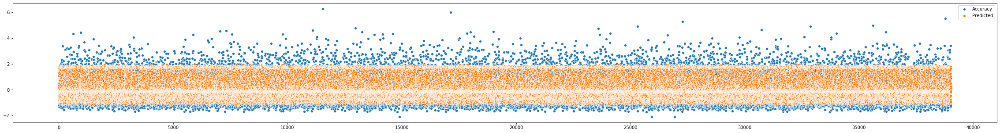

In [40]:
# predict the respose for test dataset
x = range(len(predict_y))
y1 = test_y.values
y2 = predict_y

# model accuracy to show how often the regressor is correct
mse=mean_squared_error(y2,y1)
rootmse=np.sqrt(mse)
print("MSE for D-Tree Regressor",mse,"\n")
print("RMSE for D-Tree Regressor",rootmse,"\n")

plt.figure(figsize=(40,5))
sns.scatterplot(x=x, y=y1, legend= 'full')
sns.scatterplot(x=x, y=y2, legend= 'full')
plt.legend(['Accuracy','Predicted'])
plt.show()

# Linear Regression

In [42]:
# load libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

x = preprocessed[column_list]

y = preprocessed['WindSpeed']

train_x, test_x, train_y, test_y = train_test_split(x, y, test_size=0.33, random_state=100)

model = LinearRegression().fit(train_x, train_y)
predict_y = model.predict(test_x)

for i in range(len(column_list)):
    print('%s: %.5f'%(column_list[i], model.coef_[i]))

ActivePower: 1.00180
AmbientTemperatue: -0.03750
BearingShaftTemperature: -0.02241
Blade1PitchAngle: 0.00411
Blade2PitchAngle: -1077864602.58738
Blade3PitchAngle: 1077864602.58682
GearboxBearingTemperature: 0.00243
GearboxOilTemperature: 0.00662
GeneratorRPM: 0.00767
GeneratorWinding1Temperature: -0.01864
GeneratorWinding2Temperature: 0.00850
HubTemperature: -0.00337
MainBoxTemperature: 0.00611
NacellePosition: -28372419397.90141
ReactivePower: -0.01091
RotorRPM: 0.00457
WindDirection: 28372419397.90294


MSE for Linear Regression 0.10022906461073715 

RMSE for Linear Regression 0.31658974179644095 



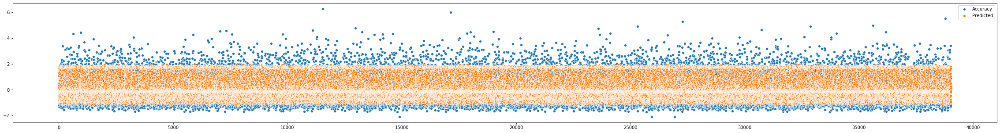

In [44]:
# predict the respose for test dataset
x = range(len(predict_y))
y1 = test_y.values
y2 = predict_y

# model accuracy to show how often the regressor is correct
mse=mean_squared_error(y2,y1)
rootmse=np.sqrt(mse)
print("MSE for Linear Regression",mse,"\n")
print("RMSE for Linear Regression",rootmse,"\n")

plt.figure(figsize=(40,5))
sns.scatterplot(x=x, y=y1, legend= 'full')
sns.scatterplot(x=x, y=y2, legend= 'full')
plt.legend(['Accuracy','Predicted'])
plt.show()

# Ensemble

In [46]:
# load libraries
from sklearn.svm import SVC
from sklearn.ensemble import VotingRegressor
from sklearn.metrics import r2_score, mean_squared_error

## Ensemble using Voting Regressor

In [48]:
X = preprocessed[column_list]
Y = preprocessed['WindSpeed']

estimators = []

model2 = DecisionTreeRegressor()
estimators.append(('cart', model2))

model3 = LinearRegression()
estimators.append(('LR', model3))

# create Voting Regressor object
ensemble = VotingRegressor(estimators)

# train VotingRegressor
eclf1 = ensemble.fit(X, Y)

# predict the respose for test dataset
y1 = eclf1.predict(X)

# model accuracy to show how often the regressor is correct
mse = mean_squared_error(Y, y1)
rootmse=(mse)**0.5
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rootmse)

Mean Squared Error (MSE): 0.025574849191950407
Root Mean Squared Error (RMSE): 0.15992138441106118


## Ensemble using AdaBoostRegressor

In [39]:
# load libraries
from sklearn.ensemble import AdaBoostRegressor

# create adaboost Regressor object
abc = AdaBoostRegressor(n_estimators=50, base_estimator=DecisionTreeRegressor())

# train adaboost Regressor
model = abc.fit(X, Y)

# predict the respose for test dataset
y_pred = model.predict(X)

# model accuracy to show how often the regressor is correct
mse = mean_squared_error(Y, y_pred)
rootmse=(mse)**0.5
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rootmse)

Mean Squared Error (MSE): 0.00025266107031875006
Root Mean Squared Error (RMSE): 0.015895315986753773


# Clustering

In [41]:
# data is clusters as per the score in various subjects
scores = imputed_df.loc[100:,["WindDirection","WindSpeed"]] 

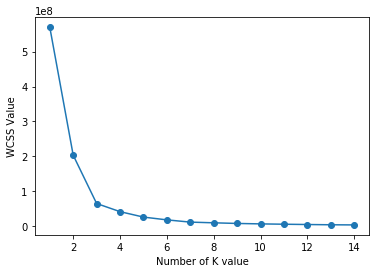

In [43]:
from sklearn.cluster import KMeans

wcss = []
for i in range(1,15):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(scores)
    wcss.append(kmeans.inertia_)

plt.plot(range(1,15),wcss,"-o")
plt.xlabel("Number of K value")
plt.ylabel("WCSS Value")
plt.show()

In [45]:
# the above graph shows that the elbowing point occurs at k=3

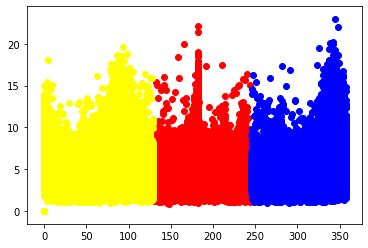

In [47]:
kmeans = KMeans(n_clusters = 3)
clusters = kmeans.fit_predict(scores)
scores["windscores"] = clusters

plt.scatter(
    scores.WindDirection[scores.windscores == 0], 
    scores.WindSpeed[scores.windscores == 0],
    color="red")
plt.scatter(
    scores.WindDirection[scores.windscores == 1], 
    scores.WindSpeed[scores.windscores == 1],
    color="blue")
plt.scatter(
    scores.WindDirection[scores.windscores == 2], 
    scores.WindSpeed[scores.windscores == 2],
    color="yellow")
plt.show()